## BUILDING A GAN USING CCNs

GANs allow generation of data by learning a distribution which mirrors that of a specific data input. Once the distribution is learned, data can be genereated. The generated data is similar but distinct from the original with the same statistics. There are two networks that make up a GAN: 

1. Generator (G) - produces fake data and maximizes on the probability of the discriminator making mistakes

2. Discriminator (D) - inspects the fake data and determines if it is real or fake 

The following architecture was builting using guidance from: 

https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [2]:
from __future__ import print_function
import os
import argparse
import random
import torch
import torchvision
import torch.nn as nn
import torch.utils.data
import torch.nn.parallel
import torch.optim as optim
import torch.nn.functional as F
from IPython.display import HTML
import torchvision.utils as vutils
import torch.backends.cudnn as cudnn
import torchvision.datasets as datasets
import matplotlib.animation as animation
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, random_split, Dataset
from sklearn.model_selection import train_test_split
import cv2
import pandas as pd
import numpy as np
#from torchvision.datasets import MNIST

import matplotlib.pyplot as plt

# Set random seed for reproducibility
manualSeed = 42
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

# CUDA for PyTorch
use_cuda = torch.cuda.is_available()
device = torch.device("cuda:0" if use_cuda else "cpu")
torch.backends.cudnn.benchmark = True

Random Seed:  42


### Setting Parameters

In [3]:
# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
img_size = 64

# Number of channels in the training images. For color images this is 3
n_channels = 3

# Size of z latent vector (i.e. size of generator input)
z_vector = 100

# Size of feature maps in generator
f_map_g = 64

# Size of feature maps in discriminator
f_map_d = 64

# Learning rate for optimizers
l_rate = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
n_gpu = 1

# Number of classes.
n_class = 12

### The DataModule  

Includes the 5 steps in processding data with PyTorch:

1. Downloading the data
2. Cleaning the data
3. Loading the data into a dataset
4. Applying transformations 
5. Wrapping the data in a dataloader

Data cleaning and preparation is usually scattered across files DataModules make resharing and reusing the splits and transformations across projects possible

In [4]:
class DatasetSample(Dataset):
    def __init__(self, df, transform):
        # Initialization
        self.transform = transform
        
        self.image_names = df['LocalPath']
        self.img_class = np.array(df['Class'])

    def __len__(self):
        # Denotes the total number of samples
        return len(self.image_names)
    
    def __getitem__(self, index):
        # Retrieves the data
        image=cv2.imread(self.image_names.iloc[index])
        image=cv2.cvtColor(image,cv2.COLOR_BGR2RGB)

        image = self.transform(image)
        label = self.img_class[index]

        x, y = image, label
        
        # Enable to output as single variable instead
        #sample = {'image': image,'labels':label}

        return x, y

In [5]:
def sipakmed_prep():
    root = "../../Python Scripts/Datasets/CervicalCancer/Sipakmed/"

    all_img = []
    for path, subdirs, files in os.walk(root):
        for name in files:
            curr_img = os.path.join(path,name)
            all_img.append(curr_img)

    sipakmed_df = pd.DataFrame()
    sipakmed_df['LocalPath'] = all_img
    sipakmed_df['ID'] = sipakmed_df['LocalPath'].apply(lambda x: str(x.split("\\")[-1]))
    sipakmed_df['Slide'] = sipakmed_df['LocalPath'].apply(lambda x: 'False' if (str(x.split("\\")[1])) == 'CROPPED' else 'True')
    sipakmed_df['Specific_Status'] = sipakmed_df['LocalPath'].apply(lambda x: str((x.split("im_")[1]).split("\\")[0]))
    sipakmed_df['Status'] = sipakmed_df['Specific_Status'].apply(lambda x: 'Benign' if x == 'Metaplastic' else
    ('Normal' if x == 'Superficial-Intermediate' or x == 'Parabasal' else 'Abnormal'))

    sp_class = {'Metaplastic':4, 'Superficial-Intermediate':0, 'Parabasal':1, 'Koilocytotic':2, 'Dyskeratotic':3}
    sipakmed_df['Specific_Class'] = sipakmed_df['Specific_Status'].map(sp_class)
    gen_class = {'Benign':0, 'Normal':1, 'Abnormal':2}
    sipakmed_df['Class'] = sipakmed_df['Status'].map(gen_class)
    
    sipakmed_df = sipakmed_df.loc[sipakmed_df['ID'].str.contains('bmp')].reset_index(drop=True)
    
    return sipakmed_df

def herlev_prep(n_class):
    root = '../../Python Scripts/Datasets/CervicalCancer/Herlev/smear2005/results.csv'
    img_folder = '../../Python Scripts/Datasets/CervicalCancer/Herlev/smear2005/Images/'

    herlev_df=pd.read_csv(root)
    herlev_df = herlev_df.rename(columns={'Class':'Specific_Class'})

    if n_class == 12:
        spec_class = {1:5, 2:6, 3:7, 4:8, 5:9, 6:10, 7:11}
    else:
        spec_class = {1:0, 2:1, 3:2, 4:3, 5:4, 6:5, 7:6}
    
    gen_class = {1:1, 2:1, 3:1, 4:2, 5:2, 6:2, 7:2}
    herlev_df['Class'] = herlev_df['Specific_Class'].map(gen_class)
    herlev_df['Specific_Class'] = herlev_df['Specific_Class'].map(spec_class)
    herlev_df['LocalPath'] = herlev_df['ID'].apply(lambda x: str(img_folder + x))
    return herlev_df

def concat_data(batch_size=128, img_size=32, n_class=3):
    kwargs = {'num_workers': 1, 'pin_memory': True} if device=='cuda' else {}
    Dtr_lst = []
    Dva_lst = []
    Dte_lst = []
    # Load the dataframes
    sipakmed_df = sipakmed_prep()
    herlev_df = herlev_prep(n_class)

    # Final adjustments to make sure they're attributes match
    sipakmed_df = sipakmed_df.loc[sipakmed_df['Slide'] == 'False']

    if n_class == 2:
        classes = ('Normal', 'Abnormal')
        herlev_df = herlev_df.loc[:,['LocalPath', 'Class']]
        sipakmed_df = sipakmed_df.loc[:,['LocalPath', 'Class']]
        concat_df = pd.concat([sipakmed_df,herlev_df], ignore_index=True)
        bin_class = {0:0, 1:0, 2:1}
        concat_df['Class'] = concat_df['Class'].map(bin_class)

    elif n_class == 3:
        classes = ('Benign', 'Normal', 'Abnormal')
        herlev_df = herlev_df.loc[:,['LocalPath', 'Class']]
        sipakmed_df = sipakmed_df.loc[:,['LocalPath', 'Class']]
        concat_df = pd.concat([sipakmed_df,herlev_df], ignore_index=True)

    elif n_class == 5:
        classes = ('Superficial-Intermediate','Parabasal','Koilocytotic','Dyskeratotic','Metaplastic')
        concat_df = pd.DataFrame()
        concat_df['LocalPath'] = sipakmed_df['LocalPath']
        concat_df['Class'] = sipakmed_df['Specific_Class']

    elif n_class == 7:
        classes = ('Superficial-Squamous-Epithelial','Intermediate-Squamous-Epithelial','Columnar-Epithelial','Mild-Squamous-Non-Keratinizing-Dysplasia',
           'Moderate-Squamous-Non-Keratinizing-Dysplasia','Severe-Squamous-Non-Keratinizing-Dysplasia','Squamous-Cell-Carcinoma-in-situ-Intermediate')
        concat_df = pd.DataFrame()
        concat_df['LocalPath'] = herlev_df['LocalPath']
        concat_df['Class'] = herlev_df['Specific_Class']

    elif n_class == 12:
        classes = ('Superficial-Intermediate','Parabasal','Koilocytotic','Dyskeratotic','Metaplastic','Superficial-Squamous-Epithelial','Intermediate-Squamous-Epithelial','Columnar-Epithelial','Mild-Squamous-Non-Keratinizing-Dysplasia',
           'Moderate-Squamous-Non-Keratinizing-Dysplasia','Severe-Squamous-Non-Keratinizing-Dysplasia','Squamous-Cell-Carcinoma-in-situ-Intermediate')
        herlev_df = herlev_df.loc[:,['LocalPath', 'Specific_Class']]
        sipakmed_df = sipakmed_df.loc[:,['LocalPath', 'Specific_Class']]
        concat_df = pd.concat([sipakmed_df,herlev_df], ignore_index=True).rename(columns={'Specific_Class':'Class'})
    
    # Set it up to alter random training images for better results
    train_transform = transforms.Compose([
                    transforms.ToPILImage(),
                    transforms.Resize((img_size, img_size)),
                    transforms.RandomHorizontalFlip(p=0.75),
                    #transforms.RandomRotation(degrees=60),
                    #transforms.transforms.ColorJitter(brightness=.2, hue=.2),
                    transforms.ToTensor()])

    test_transform = transforms.Compose([
                    transforms.ToPILImage(),
                    transforms.Resize((img_size, img_size)),
                    transforms.ToTensor()])

    train_set,val_test_set = train_test_split(concat_df, random_state=1, test_size=0.40)
    val_set,test_set = train_test_split(concat_df, random_state=1, test_size=0.50)

    for i in range(n_class):
        temp_df = pd.concat([train_set, val_set], ignore_index=True)
        temp_df = temp_df.loc[temp_df['Class'] == i]

        # Split them into training, validation, and testing sets

        train_dataset = DatasetSample(train_set, train_transform)
        #val_dataset = DatasetSample(val_set, test_transform)
        test_dataset = DatasetSample(test_set, test_transform)

        Dtr = DataLoader(
            train_dataset,
            batch_size=batch_size,
            shuffle=True,
            generator=torch.Generator().manual_seed(17),
            **kwargs
        )
        '''
        Dva = DataLoader(
            val_dataset, 
            batch_size=batch_size,
            shuffle=False,
            **kwargs
        )
        '''
        Dte = DataLoader(
            test_dataset, 
            batch_size=batch_size,
            shuffle=False,
            **kwargs
        )

        Dtr_lst.append(Dtr)
        #Dva_lst.append(Dva)
        Dte_lst.append(Dte)

    

    return(Dtr_lst, Dte_lst, concat_df) #Dva_lst, Dte_lst)

### Weight Initialization

In [6]:
# custom weights initialization called on netG and netD
def weights_init(m):
    
    # Extra layer just to be doubly sure that it doesnt carry info between classes
    for layers in netG.children():
        for layer in layers:
            if hasattr(layer, 'reset_parameters'):
                layer.reset_parameters()
    for layers in netD.children():
        for layer in layers:
            if hasattr(layer, 'reset_parameters'):
                layer.reset_parameters()
                
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### Creating the Generator

In [7]:
# Generator Code

class Generator(nn.Module):
    def __init__(self,n_gpu=1):
        super(Generator, self).__init__()
        self.ngpu = n_gpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( z_vector, f_map_g * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(f_map_g * 8),
            nn.ReLU(True),
            # state size. (f_map_g*8) x 4 x 4
            nn.ConvTranspose2d(f_map_g * 8, f_map_g * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(f_map_g * 4),
            nn.ReLU(True),
            # state size. (f_map_g*4) x 8 x 8
            nn.ConvTranspose2d( f_map_g * 4, f_map_g * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(f_map_g * 2),
            nn.ReLU(True),
            # state size. (f_map_g*2) x 16 x 16
            nn.ConvTranspose2d( f_map_g * 2, f_map_g, 4, 2, 1, bias=False),
            nn.BatchNorm2d(f_map_g),
            nn.ReLU(True),
            # state size. (f_map_g) x 32 x 32
            nn.ConvTranspose2d( f_map_g, n_channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (n_channels) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Print the model
print(Generator(n_gpu))

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


### Creating the Discriminator 

In [9]:
class Discriminator(nn.Module):
    def __init__(self, n_gpu=1):
        super(Discriminator, self).__init__()
        self.ngpu = n_gpu
        self.main = nn.Sequential(
            # input is (n_channels) x 64 x 64
            nn.Conv2d(n_channels, f_map_d, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (f_map_d) x 32 x 32
            nn.Conv2d(f_map_d, f_map_d * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(f_map_d * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (f_map_d*2) x 16 x 16
            nn.Conv2d(f_map_d * 2, f_map_d * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(f_map_d * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (f_map_d*4) x 8 x 8
            nn.Conv2d(f_map_d * 4, f_map_d * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(f_map_d * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (f_map_d*8) x 4 x 4
            nn.Conv2d(f_map_d * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Print the model
print(Discriminator(n_gpu))

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


### Join Networks Together to Create One Class

In [11]:
# Training Loop
def batch_gd(netG, netD, train_loader, epochs, class_number):
    # Lists to keep track of progress
    img_list = []
    G_losses = []
    D_losses = []
    G_loss_mean = []
    D_loss_mean = []
    iters = 0
    
    if (device.type == 'cuda') and (n_gpu > 1):
        netG = nn.DataParallel(netG, list(range(n_gpu)))
        netD = nn.DataParallel(netD, list(range(n_gpu)))

    netG.apply(weights_init)
    netD.apply(weights_init)

    print("Starting Training Loop...")
    # For each epoch
    for epoch in range(epochs):
        # For each batch in the dataloader
        for i, data in enumerate(train_loader, 0):
            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            ## Train with all-real batch
            netD.zero_grad()
            # Format batch
            real_cpu = data[0].to(device)
            b_size = real_cpu.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            # Forward pass real batch through D
            output = netD(real_cpu).view(-1)
            # Calculate loss on all-real batch
            errD_real = criterion(output, label)
            # Calculate gradients for D in backward pass
            errD_real.backward()
            D_x = output.mean().item()

            ## Train with all-fake batch
            # Generate batch of latent vectors
            noise = torch.randn(b_size, z_vector, 1, 1, device=device)
            # Generate fake image batch with G
            fake = netG(noise)
            label.fill_(fake_label)
            # Classify all fake batch with D
            output = netD(fake.detach()).view(-1)
            # Calculate D's loss on the all-fake batch
            errD_fake = criterion(output, label)
            # Calculate the gradients for this batch, accumulated (summed) with previous gradients
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            # Compute error of D as sum over the fake and the real batches
            errD = errD_real + errD_fake
            # Update D
            optimizerD.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            netG.zero_grad()
            label.fill_(real_label)  # fake labels are real for generator cost
            # Since we just updated D, perform another forward pass of all-fake batch through D
            output = netD(fake).view(-1)
            # Calculate G's loss based on this output
            errG = criterion(output, label)
            # Calculate gradients for G
            errG.backward()
            D_G_z2 = output.mean().item()
            # Update G
            optimizerG.step()

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())
            G_mean = np.mean(G_losses)
            D_mean = np.mean(D_losses)

            # Computes the average loss for a cleaner view
            G_loss_mean.append(G_mean)
            D_loss_mean.append(D_mean)

            # Output training stats
            if i % 50 == 0:
                print('Class:[%d/%d] Epoch:[%d/%d] Loss_D(Current/Avg):[%.4f/%.4f] Loss_G(Current/Avg):[%.4f/%.4f] D(x): %.4f D(G(z)): %.4f / %.4f'
                    % (class_number+1, n_class, epoch+1, epochs, errD.item(), D_mean, errG.item(), G_mean, D_x, D_G_z1, D_G_z2))         

            # Check how the generator is doing by saving G's output on fixed_noise
            if (iters % 250 == 0) or ((epoch == epochs-1) and (i == len(train_loader)-1)):
                with torch.no_grad():
                    fake = netG(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            iters += 1

    # Generate the images for the transformer
    with torch.no_grad():
        gen_img = netG(fixed_noise_gen).detach().cpu()
            
    return img_list, G_loss_mean, D_loss_mean, gen_img

### Testing the GAN 

In [12]:
class_img_list = []
G_loss_list = []
D_loss_list = []
fake_list = []
class_counter = []

# Establich Generator and Discriminator
netG = Generator(n_gpu).to(device)
netD = Discriminator(n_gpu).to(device)

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, z_vector, 1, 1, device=device)


# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

Dtr_lst, Dte_lst, concat_df = concat_data(batch_size=batch_size, img_size=img_size, n_class=n_class)

for i in range(n_class):
    class_counter.append(concat_df['Class'].loc[(concat_df['Class'] == i)].count())

for i in range(n_class):
    # Initialize BCELoss function
    criterion = nn.BCELoss()

    # Setup Adam optimizers for both G and D
    optimizerD = optim.Adam(netD.parameters(), lr=l_rate, betas=(beta1, 0.999))
    optimizerG = optim.Adam(netG.parameters(), lr=l_rate, betas=(beta1, 0.999))

    diff_class = int((max(class_counter) - class_counter[i]) / 2)
    fixed_noise_gen = torch.randn(diff_class, z_vector, 1, 1, device=device)
    
    img_list, G_losses, D_losses, fake = batch_gd(netG, netD, Dtr_lst[i], epochs=350, class_number=i)

    class_img_list.append(img_list)
    G_loss_list.append(G_losses)
    D_loss_list.append(D_losses)
    fake_list.append(fake)


Starting Training Loop...
Class:[1/12] Epoch:[1/350] Loss_D(Current/Avg):[1.5880/1.5880] Loss_G(Current/Avg):[2.3673/2.3673] D(x): 0.4444 D(G(z)): 0.5276 / 0.0970
Class:[1/12] Epoch:[2/350] Loss_D(Current/Avg):[0.0127/0.1686] Loss_G(Current/Avg):[7.6432/6.4484] D(x): 0.9976 D(G(z)): 0.0103 / 0.0005
Class:[1/12] Epoch:[3/350] Loss_D(Current/Avg):[0.0058/0.0905] Loss_G(Current/Avg):[7.6395/7.1233] D(x): 0.9983 D(G(z)): 0.0041 / 0.0005
Class:[1/12] Epoch:[4/350] Loss_D(Current/Avg):[0.0053/0.0628] Loss_G(Current/Avg):[8.3659/7.4602] D(x): 0.9989 D(G(z)): 0.0042 / 0.0002
Class:[1/12] Epoch:[5/350] Loss_D(Current/Avg):[0.1920/0.4200] Loss_G(Current/Avg):[3.5055/7.7723] D(x): 0.9177 D(G(z)): 0.0967 / 0.0303
Class:[1/12] Epoch:[6/350] Loss_D(Current/Avg):[0.0933/0.3623] Loss_G(Current/Avg):[7.4125/7.3788] D(x): 0.9171 D(G(z)): 0.0019 / 0.0008
Class:[1/12] Epoch:[7/350] Loss_D(Current/Avg):[3.3162/0.3489] Loss_G(Current/Avg):[8.8651/7.1571] D(x): 0.8790 D(G(z)): 0.8919 / 0.0007
Class:[1/12] Ep

### Visualizations

In [ ]:
# Normalizes generated images so all pixel values are between 0 and 1
def norm_img(img):
    mini = img.min()
    maxi = img.max()
    diff = maxi-mini
    temp = (img - mini) / diff
    return temp

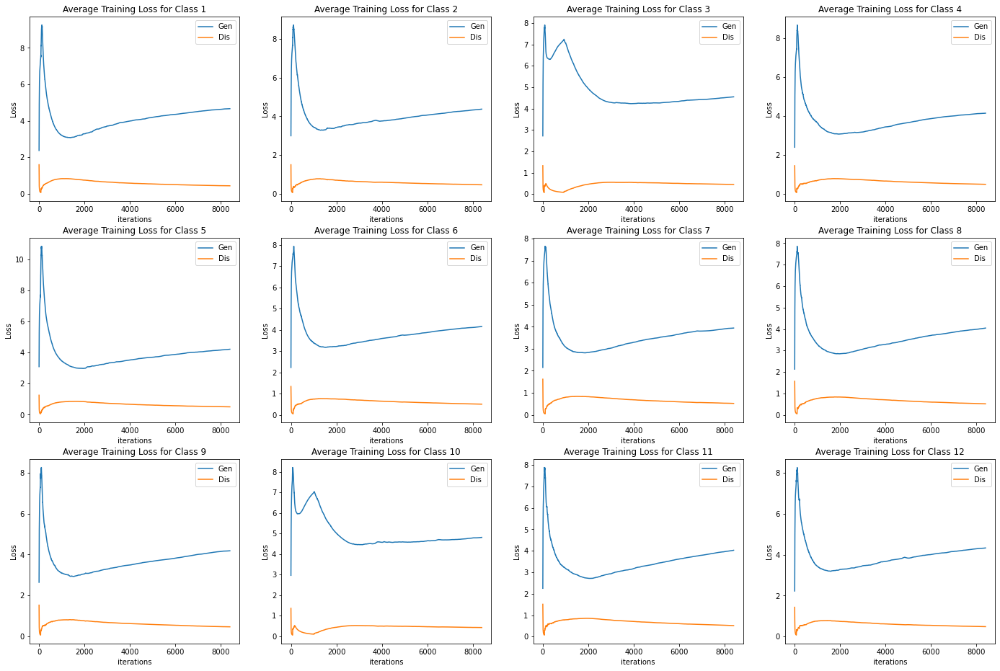

In [ ]:
plt.figure(figsize=(24,16))

for i in range(n_class):
    ax = plt.subplot(3,4,i+1)
    ax.plot(G_loss_list[i],label="Gen")
    ax.plot(D_loss_list[i],label="Dis")
    plt.title('Average Training Loss for Class {}'.format(i+1))
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
plt.subplots_adjust()
plt.show()

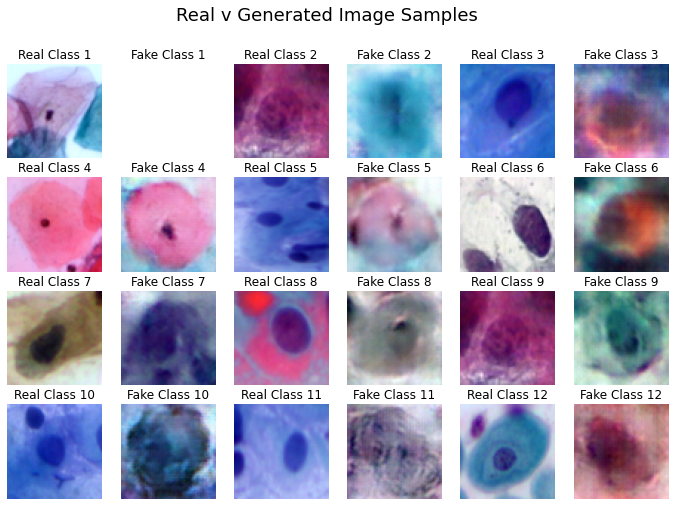

In [ ]:
plt.figure(figsize=(12,8))
ax_count = 1

for i in range(n_class):

    temp_img_list = fake_list[i]
    real_batch = next(iter(Dtr_lst[i]))
    
    # Plot the real images
    ax = plt.subplot(4,6,ax_count)
    plt.axis("off")
    plt.title('Real Class {}'.format(i+1))
    plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[random.choice(range(len(real_batch[0])))], normalize=True).cpu(),(1,2,0)))
    ax_count += 1

    # Plot the fake images from the last epoch
    ax = plt.subplot(4,6,ax_count)
    plt.axis("off")
    plt.title('Fake Class {}'.format(i+1))
    if len(temp_img_list) != 0:
        img = norm_img(np.array(temp_img_list[random.choice(range(len(temp_img_list)))]))
        plt.imshow(np.transpose(img, (1,2,0)))
    ax_count += 1

plt.suptitle('Real v Generated Image Samples', fontsize=18)
plt.subplots_adjust(wspace=0.1, hspace=0.2)
plt.show()

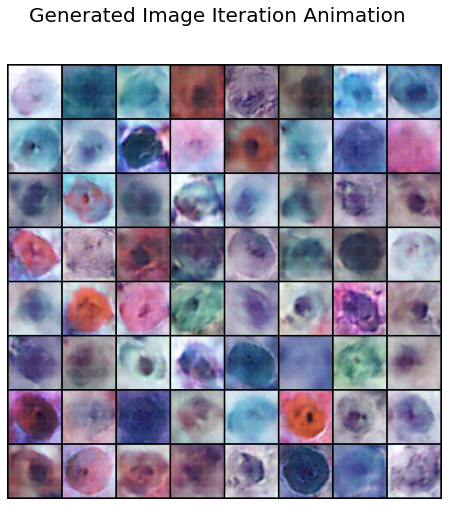

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
img_list = class_img_list[random.choice(range(n_class))]
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

plt.suptitle('Generated Image Iteration Animation', fontsize=20)
HTML(ani.to_jshtml())

In [ ]:
#for i in range(n_class):
mean_real_df = pd.DataFrame()
mean_fake_df = pd.DataFrame()

for c_num in range(n_class):
    real_batch = next(iter(Dtr_lst[c_num]))
    real_df = pd.DataFrame()
    for i in random.choices(range(len(real_batch[0])), k=10):
        t = np.array(torch.flatten(real_batch[0][i].to(device)).cpu())
        real_df[i] = t

    mean_real_df[c_num] = real_df.mean(axis=1)

    fake_df = pd.DataFrame()
    
    if len(fake_list[c_num]) != 0:
        for i in random.choices(range(len(fake_list[c_num])), k=10):
            t = np.array(torch.flatten(fake_list[c_num][i].to(device)).cpu())
            fake_df[i] = t

        mean_fake_df[c_num] = fake_df.mean(axis=1)

    
'''
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[random.choice(range(len(real_batch[0])))], normalize=True).cpu(),(1,2,0)))
ax_count += 1

# Plot the fake images from the last epoch
ax = plt.subplot(4,6,ax_count)
plt.axis("off")
plt.title('Fake Class {}'.format(i+1))
if len(temp_img_list) != 0:
    img = norm_img(np.array(temp_img_list[random.choice(range(len(temp_img_list)))]))
    plt.imshow(np.transpose(img, (1,2,0)))
ax_count += 1
'''

display(mean_real_df)
display(mean_fake_df)

NameError: name 'pd' is not defined

In [ ]:
real_cosin_df = pd.DataFrame()
for i in range(n_class):
    temp_list = []
    for j in range(n_class):
        cosine = np.dot(mean_real_df[i],mean_real_df[j])/(np.linalg.norm(mean_real_df[i])*np.linalg.norm(mean_real_df[j]))
        temp_list.append(cosine)
    real_cosin_df['Real ' + str(i+1)] = temp_list
real_cosin_df.index = ['Real 1', 'Real 2', 'Real 3', 'Real 4', 'Real 5', 'Real 6', 'Real 7', 'Real 8', 'Real 9', 'Real 10', 'Real 11', 'Real 12']
display(real_cosin_df)

fake_cosin_df = pd.DataFrame()
for i in range(n_class):
    temp_list = []
    for j in range(n_class):
        if i == 0 or j == 0:
            temp_list.append(0)
            continue
        cosine = np.dot(mean_fake_df[i],mean_fake_df[j])/(np.linalg.norm(mean_fake_df[i])*np.linalg.norm(mean_fake_df[j]))
        temp_list.append(cosine)
    fake_cosin_df['Fake ' + str(i+1)] = temp_list
fake_cosin_df.index = ['Fake 1', 'Fake 2', 'Fake 3', 'Fake 4', 'Fake 5', 'Fake 6', 'Fake 7', 'Fake 8', 'Fake 9', 'Fake 10', 'Fake 11', 'Fake 12']
display(fake_cosin_df)


,Real 1,Real 2,Real 3,Real 4,Real 5,Real 6,Real 7,Real 8,Real 9,Real 10,Real 11,Real 12
Real 1,1.000000,0.990666,0.997326,0.996724,0.996998,0.996148,0.994702,0.993010,0.997140,0.992429,0.995394,0.990326
Real 2,0.990666,1.000000,0.994785,0.989738,0.993375,0.993879,0.995517,0.995097,0.993657,0.994354,0.995314,0.998346
Real 3,0.997326,0.994785,1.000000,0.995276,0.997498,0.996859,0.996677,0.996251,0.997463,0.995285,0.996943,0.995041
Real 4,0.996724,0.989738,0.995276,1.000000,0.996382,0.997490,0.993876,0.992278,0.995138,0.991907,0.993643,0.988556
Real 5,0.996998,0.993375,0.997498,0.996382,1.000000,0.997935,0.996803,0.996280,0.996684,0.995556,0.995908,0.993265
Real 6,0.996148,0.993879,0.996859,0.997490,0.997935,1.000000,0.995237,0.994948,0.996048,0.994137,0.995149,0.992964
Real 7,0.994702,0.995517,0.996677,0.993876,0.996803,0.995237,1.000000,0.996047,0.996261,0.995761,0.996794,0.995580
Real 8,0.993010,0.995097,0.996251,0.992278,0.996280,0.994948,0.996047,1.000000,0.994732,0.996953,0.995553,0.994911
Real 9,0.997140,0.993657,0.997463,0.995138,0.996684,0.996048,0.996261,0.994732,1.000000,0.993162,0.995797,0.992952
Real 10,0.992429,0.994354,0.995285,0.991907,0.995556,0.994137,0.995761,0.996953,0.993162,1.000000,0.997304,0.995165


,Fake 1,Fake 2,Fake 3,Fake 4,Fake 5,Fake 6,Fake 7,Fake 8,Fake 9,Fake 10,Fake 11,Fake 12
Fake 1,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Fake 2,0,1.000000,0.992765,0.993187,0.990211,0.992184,0.992959,0.991043,0.990471,0.994651,0.993357,0.995152
Fake 3,0,0.992765,1.000000,0.992739,0.988716,0.992906,0.994301,0.991235,0.990811,0.992715,0.994137,0.992639
Fake 4,0,0.993187,0.992739,1.000000,0.992168,0.995528,0.995370,0.993018,0.995618,0.994484,0.995560,0.995049
Fake 5,0,0.990211,0.988716,0.992168,1.000000,0.991929,0.992671,0.989283,0.990855,0.986515,0.992067,0.989799
Fake 6,0,0.992184,0.992906,0.995528,0.991929,1.000000,0.996454,0.992120,0.993867,0.993335,0.994004,0.994064
Fake 7,0,0.992959,0.994301,0.995370,0.992671,0.996454,1.000000,0.994563,0.993569,0.993622,0.995455,0.993192
Fake 8,0,0.991043,0.991235,0.993018,0.989283,0.992120,0.994563,1.000000,0.991043,0.991470,0.992498,0.991596
Fake 9,0,0.990471,0.990811,0.995618,0.990855,0.993867,0.993569,0.991043,1.000000,0.993123,0.995252,0.995178
Fake 10,0,0.994651,0.992715,0.994484,0.986515,0.993335,0.993622,0.991470,0.993123,1.000000,0.993770,0.996351


In [ ]:
cosine_df = pd.DataFrame()
for i in range(n_class):
    temp_list = []
    for j in range(n_class):
        if i == 0 or j == 0:
            temp_list.append(0)
            continue
        cosine = np.dot(mean_real_df[i],mean_fake_df[j])/(np.linalg.norm(mean_real_df[i])*np.linalg.norm(mean_fake_df[j]))
        temp_list.append(cosine)
    cosine_df['Real ' + str(i+1)] = temp_list

cosine_df.index = ['Fake 1', 'Fake 2', 'Fake 3', 'Fake 4', 'Fake 5', 'Fake 6', 'Fake 7', 'Fake 8', 'Fake 9', 'Fake 10', 'Fake 11', 'Fake 12']
display(cosine_df)

,Real 1,Real 2,Real 3,Real 4,Real 5,Real 6,Real 7,Real 8,Real 9,Real 10,Real 11,Real 12
Fake 1,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Fake 2,0,0.996291,0.992873,0.988981,0.992260,0.992008,0.994201,0.991444,0.991687,0.991600,0.993950,0.996029
Fake 3,0,0.993788,0.993695,0.989746,0.992248,0.992401,0.993519,0.992550,0.992313,0.994208,0.995499,0.993753
Fake 4,0,0.994728,0.996007,0.993553,0.996918,0.995088,0.997256,0.996304,0.995461,0.994633,0.995100,0.994335
Fake 5,0,0.990903,0.993860,0.991998,0.993446,0.992726,0.991814,0.991496,0.995836,0.990176,0.991698,0.990330
Fake 6,0,0.994837,0.995874,0.993527,0.996217,0.996157,0.995073,0.996107,0.996168,0.995423,0.996032,0.994281
Fake 7,0,0.994812,0.996634,0.994775,0.996462,0.996955,0.996269,0.995202,0.996627,0.995090,0.996359,0.994508
Fake 8,0,0.991637,0.993226,0.995952,0.995019,0.996310,0.994601,0.992285,0.991844,0.992794,0.993424,0.990344
Fake 9,0,0.993575,0.994801,0.991242,0.994926,0.993188,0.995911,0.997096,0.993159,0.995854,0.994414,0.992952
Fake 10,0,0.996241,0.993302,0.988241,0.993689,0.993049,0.995145,0.994380,0.990644,0.994974,0.994408,0.996706


In [ ]:
for i in range(1,n_class):
    cosine = np.dot(mean_real_df[i],mean_fake_df[i])/(np.linalg.norm(mean_real_df[i])*np.linalg.norm(mean_fake_df[i]))
    print("Cosine Similarity between average real and fake images in Class {}:  {}".format(i+1,cosine))

Cosine Similarity between average real and fake images in Class 2:  0.9962911605834961
Cosine Similarity between average real and fake images in Class 3:  0.993694543838501
Cosine Similarity between average real and fake images in Class 4:  0.9935526847839355
Cosine Similarity between average real and fake images in Class 5:  0.9934459924697876
Cosine Similarity between average real and fake images in Class 6:  0.9961569309234619
Cosine Similarity between average real and fake images in Class 7:  0.9962688684463501
Cosine Similarity between average real and fake images in Class 8:  0.9922850131988525
Cosine Similarity between average real and fake images in Class 9:  0.9931586980819702
Cosine Similarity between average real and fake images in Class 10:  0.9949743747711182
Cosine Similarity between average real and fake images in Class 11:  0.9958798885345459
Cosine Similarity between average real and fake images in Class 12:  0.996419370174408


### Saves Generated Images

In [ ]:
def save_gan_img():
    for i in range(n_class):
        if len(fake_list[i]) != 0:
            temp_img_list = fake_list[i]
            dest = '../../Python Scripts/Datasets/CervicalCancer/Generated/'
            spec_dest = '../../Python Scripts/Datasets/CervicalCancer/Generated/{}/'.format(i)
            if os.path.exists(dest) == False: 
                os.mkdir(dest)
            if os.path.exists(spec_dest) == False: 
                os.mkdir(spec_dest)            
            for j in range(len(temp_img_list)):
                img = np.array(temp_img_list[j])
                temp_img = norm_img(img)
                plt.imsave('../../Python Scripts/Datasets/CervicalCancer/Generated/{}/fake{:02d}{:03d}.bmp'.
                            format(i, i, j+1),np.transpose(temp_img,(1,2,0)))

save_gan_img()